### Price Optimazation

Main objective of this analysis is to learn how customers respond to price variation in order to meet business goals, for instance generating more profit. Questions:
* how buyng patterns relate to prices of the products
* how to optimize price to generate higher revenue 

Strategies to price products:
* cost plus based pricing
* competition based pricing
* perceived value based pricing
* demand based pricing

The main question you can ask is 'How should I price my products based on sales data, which I do have?'


The central pattern we consider to be analysed is called price elasticity. Price elasticity of demand is an economic measure of the change in the quantity demanded or purchased of a product in relation to its price change. Expressed mathematically, it is:


![title](img/price_elasticity_formula.png)

Price elasticity is used by economists to understand how supply or demand changes given changes in price to understand the workings of the real economy. For instance, some goods are very inelastic, that is, their prices do not change very much given changes in supply or demand, for example people need to buy gasoline to get to work or travel around the world, and so if oil prices rise, people will likely still buy just the same amount of gas. On the other hand, certain goods are very elastic, their price moves cause substantial changes in its demand or its supply.

In [1]:
# import the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sbn
import statsmodels.api as sm
from statsmodels.formula.api import ols
sbn.set(style='ticks', color_codes=True)

import sys
sys.path.append('./helpers/utils.py')

from helpers.utils import uniques

In [2]:
# load the data
sales_df = pd.read_csv('./data/raw/CafeSellMetaData.csv')
transactions_df = pd.read_csv('./data/raw/CafeTransactionStore.csv')
date_df = pd.read_csv('./data/raw/CafeDateInfo.csv')

#### Explore sales data

In [3]:
sales_df

,SELL_ID,SELL_CATEGORY,ITEM_ID,ITEM_NAME
0,1070,0,7821,BURGER
1,3055,0,3052,COFFEE
2,3067,0,5030,COKE
3,3028,0,6249,LEMONADE
4,2051,2,7821,BURGER
5,2051,2,5030,COKE
6,2052,2,7821,BURGER
7,2052,2,6249,LEMONADE
8,2053,2,7821,BURGER
9,2053,2,5030,COKE


In [4]:
sales_df.shape

(11, 4)

In [5]:
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11 entries, 0 to 10
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   SELL_ID        11 non-null     int64 
 1   SELL_CATEGORY  11 non-null     int64 
 2   ITEM_ID        11 non-null     int64 
 3   ITEM_NAME      11 non-null     object
dtypes: int64(3), object(1)
memory usage: 480.0+ bytes


In [6]:
sales_df.describe(include='all')

,SELL_ID,SELL_CATEGORY,ITEM_ID,ITEM_NAME
count,11.000000,11.000000,11.000000,11
unique,NaN,NaN,NaN,4
top,NaN,NaN,NaN,BURGER
freq,NaN,NaN,NaN,4
mean,2235.000000,1.272727,5906.909091,NaN
std,598.728653,1.009050,1830.217170,NaN
min,1070.000000,0.000000,3052.000000,NaN
25%,2051.500000,0.000000,5030.000000,NaN
50%,2053.000000,2.000000,6249.000000,NaN
75%,2540.500000,2.000000,7821.000000,NaN


In [7]:
# duplicates check
sales_df.duplicated().sum()

0

In [8]:
# missing values check
sales_df.isnull().sum()

SELL_ID          0
SELL_CATEGORY    0
ITEM_ID          0
ITEM_NAME        0
dtype: int64

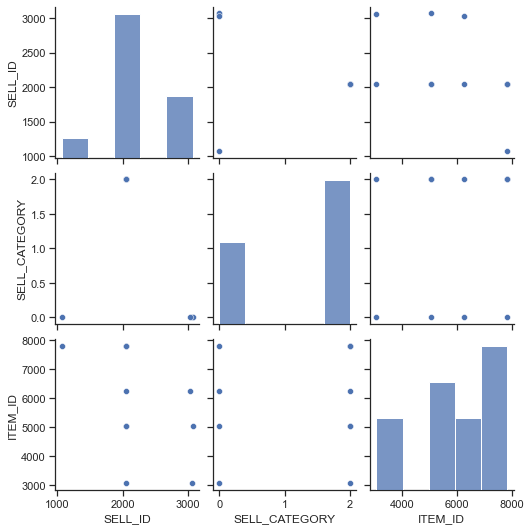

In [9]:
sbn.pairplot(sales_df)

In [10]:
# unique values
uniques(sales_df)

{'SELL_ID': array([1070, 3055, 3067, 3028, 2051, 2052, 2053]),
 'SELL_CATEGORY': array([0, 2]),
 'ITEM_ID': array([7821, 3052, 5030, 6249]),
 'ITEM_NAME': array(['BURGER', 'COFFEE', 'COKE', 'LEMONADE'], dtype=object)}

#### Explore transactions data

In [11]:
transactions_df.head()

,CALENDAR_DATE,PRICE,QUANTITY,SELL_ID,SELL_CATEGORY
0,01/01/12,15.50,46,1070,0
1,01/01/12,12.73,22,2051,2
2,01/01/12,12.75,18,2052,2
3,01/01/12,12.60,30,2053,2
4,01/02/12,15.50,70,1070,0


In [12]:
transactions_df.shape

(5404, 5)

In [13]:
# info
transactions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5404 entries, 0 to 5403
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CALENDAR_DATE  5404 non-null   object 
 1   PRICE          5404 non-null   float64
 2   QUANTITY       5404 non-null   int64  
 3   SELL_ID        5404 non-null   int64  
 4   SELL_CATEGORY  5404 non-null   int64  
dtypes: float64(1), int64(3), object(1)
memory usage: 211.2+ KB


In [14]:
# description
transactions_df.describe(include='all')

,CALENDAR_DATE,PRICE,QUANTITY,SELL_ID,SELL_CATEGORY
count,5404,5404.000000,5404.000000,5404.00000,5404.000000
unique,1348,NaN,NaN,NaN,NaN
top,03/01/13,NaN,NaN,NaN,NaN
freq,16,NaN,NaN,NaN,NaN
mean,NaN,12.868729,44.335307,1806.50000,1.500000
std,NaN,1.563922,25.502597,425.25841,0.866106
min,NaN,10.120000,8.000000,1070.00000,0.000000
25%,NaN,11.530000,24.000000,1805.75000,1.500000
50%,NaN,12.640000,36.000000,2051.50000,2.000000
75%,NaN,13.557500,60.000000,2052.25000,2.000000


In [15]:
# duplicates check
transactions_df.duplicated().sum()

3

In [16]:
# missing values check
transactions_df.isnull().sum()

CALENDAR_DATE    0
PRICE            0
QUANTITY         0
SELL_ID          0
SELL_CATEGORY    0
dtype: int64

In [17]:
# look deeper at duplicates values
transactions_df[transactions_df.duplicated(keep=False)]

,CALENDAR_DATE,PRICE,QUANTITY,SELL_ID,SELL_CATEGORY
1696,03/01/13,15.50,90,1070,0
1702,03/01/13,13.41,40,2052,2
1703,03/01/13,13.41,40,2053,2
1704,03/01/13,15.50,90,1070,0
1710,03/01/13,13.41,40,2052,2
1711,03/01/13,13.41,40,2053,2


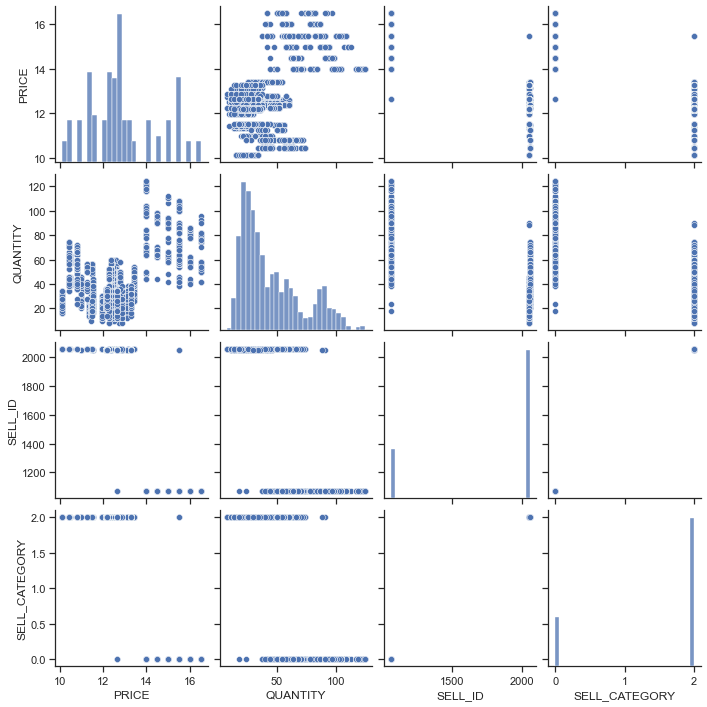

In [18]:
# plot 
sbn.pairplot(transactions_df)

In [19]:
uniques(transactions_df)

{'CALENDAR_DATE': array(['01/01/12', '01/02/12', '01/03/12', ..., '09/08/15', '09/09/15',
        '09/10/15'], dtype=object),
 'PRICE': array([15.5 , 12.73, 12.75, 12.6 , 15.  , 11.49, 11.36, 10.47, 12.35,
        12.49, 12.42, 13.13, 12.64, 13.41, 16.5 , 13.08, 12.72, 12.46,
        14.  , 10.97, 10.12, 10.45, 13.27, 11.96, 12.37, 14.5 , 12.14,
        11.34, 11.48, 12.87, 12.85, 12.77, 11.53, 11.45, 10.81, 16.  ,
        12.66, 12.26, 12.19, 11.5 , 11.26]),
 'QUANTITY': array([ 46,  22,  18,  30,  70,  16,  34,  62,  26,  12,  28,  88,  24,
         42, 104,  36,  58, 100,  38,  20,  54, 106, 108,  40,  32,  52,
        102,  60,  74,  56,  86,  14,  84,  90,  48,  64,   8,  44,  76,
         72,  82,  50,  94,  66,  92,  10, 110,  78, 112,  68,  80,  96,
        122,  98, 124, 120, 118, 116]),
 'SELL_ID': array([1070, 2051, 2052, 2053]),
 'SELL_CATEGORY': array([0, 2])}

#### Explore date data

In [20]:
date_df.head()

,CALENDAR_DATE,YEAR,HOLIDAY,IS_WEEKEND,IS_SCHOOLBREAK,AVERAGE_TEMPERATURE,IS_OUTDOOR
0,1/1/12,2012,New Year,1,0,24.8,0
1,1/2/12,2012,New Year,0,0,24.8,0
2,1/3/12,2012,New Year,0,0,32.0,1
3,1/4/12,2012,NaN,0,0,32.0,1
4,1/5/12,2012,NaN,0,0,24.8,0


In [21]:
date_df.shape

(1349, 7)

In [22]:
# info
date_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1349 entries, 0 to 1348
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   CALENDAR_DATE        1349 non-null   object 
 1   YEAR                 1349 non-null   int64  
 2   HOLIDAY              105 non-null    object 
 3   IS_WEEKEND           1349 non-null   int64  
 4   IS_SCHOOLBREAK       1349 non-null   int64  
 5   AVERAGE_TEMPERATURE  1349 non-null   float64
 6   IS_OUTDOOR           1349 non-null   int64  
dtypes: float64(1), int64(4), object(2)
memory usage: 73.9+ KB


In [23]:
# description
date_df.describe(include='all')

,CALENDAR_DATE,YEAR,HOLIDAY,IS_WEEKEND,IS_SCHOOLBREAK,AVERAGE_TEMPERATURE,IS_OUTDOOR
count,1349,1349.000000,105,1349.000000,1349.000000,1349.000000,1349.000000
unique,1348,NaN,8,NaN,NaN,NaN,NaN
top,3/1/13,NaN,Luner New Year,NaN,NaN,NaN,NaN
freq,2,NaN,28,NaN,NaN,NaN,NaN
mean,NaN,2013.375093,NaN,0.285397,0.204596,56.326019,0.862120
std,NaN,1.073073,NaN,0.451771,0.403556,20.227597,0.344902
min,NaN,2012.000000,NaN,0.000000,0.000000,14.000000,0.000000
25%,NaN,2012.000000,NaN,0.000000,0.000000,35.600000,1.000000
50%,NaN,2013.000000,NaN,0.000000,0.000000,60.800000,1.000000
75%,NaN,2014.000000,NaN,1.000000,0.000000,75.200000,1.000000


In [24]:
# duplicates check
date_df.duplicated().sum()

0

In [25]:
# missing values check
date_df.isnull().sum()

CALENDAR_DATE             0
YEAR                      0
HOLIDAY                1244
IS_WEEKEND                0
IS_SCHOOLBREAK            0
AVERAGE_TEMPERATURE       0
IS_OUTDOOR                0
dtype: int64

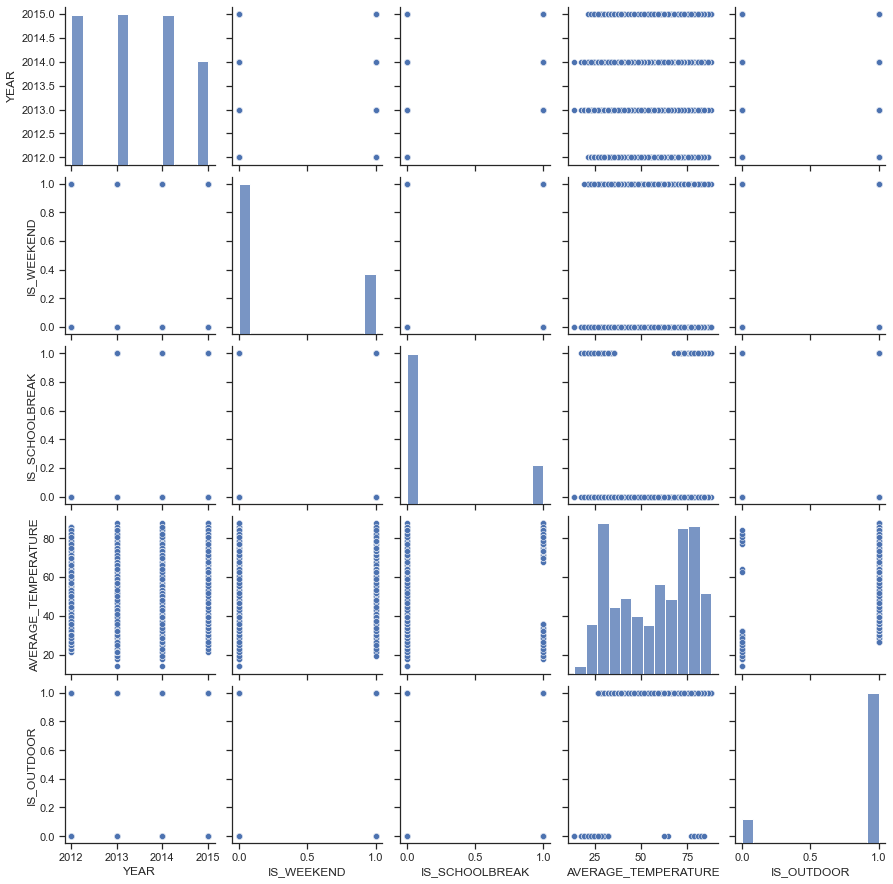

In [26]:
# plot 
sbn.pairplot(date_df)

In [27]:
# uniques values
uniques(date_df)

{'CALENDAR_DATE': array(['1/1/12', '1/2/12', '1/3/12', ..., '9/8/15', '9/9/15', '9/10/15'],
       dtype=object),
 'YEAR': array([2012, 2013, 2014, 2015]),
 'HOLIDAY': array(['New Year', nan, 'Luner New Year', 'Qing Ming Festival',
        'Labor Day', 'Dragon Boat Festivel', 'Mid-Autumn Day',
        'National Day', 'WWII Celebration'], dtype=object),
 'IS_WEEKEND': array([1, 0]),
 'IS_SCHOOLBREAK': array([0, 1]),
 'AVERAGE_TEMPERATURE': array([24.8, 32. , 23. , 26.6, 21.2, 28.4, 37.4, 39.2, 42.8, 30.2, 33.8,
        35.6, 41. , 44.6, 46.4, 50. , 55.4, 48.2, 51.8, 57.2, 53.6, 60.8,
        62.6, 66.2, 69.8, 64.4, 68. , 59. , 71.6, 75.2, 73.4, 80.6, 77. ,
        82.4, 78.8, 84.2, 86. , 19.4, 17.6, 87.8, 14. ]),
 'IS_OUTDOOR': array([0, 1])}

Initial observations:

1. Sales:
 * there are no missing and duplicated values in the dataset
 * item_name is a more descriptive form of item_id
 * sell_id is an id for particular combination of items
 * sell_category has two possible values, specifying if product was bought individually or with other item
 * there are 4 product labels - 'BURGER' (sold individually and in tandem with other items), 'COFFEE', 'COKE', 'LEMONADE
2. Transactions:
 * there are duplicates and no missing values in the dataset
 * the dataset contains such important features as price, quantity, date, sell_category (is item bought individually?), sell_id(id of unique combination)
 * pairplot shown interesting relation of price and quantity. It looks like there are two clusters of data with higher prices/higher quantity and lower price/lower quantity
3. Date:
 * there are missing values in the column 'HOLIDAY'
 * calendar_date contains all necessary information so column 'year' seems to be extra
 * it is not clear where temperature comes from (is it inside or outside temperature?)
 * calendar_date field has a different format in comparison with transactions data


### Basic preprocessing

In [28]:
# remove duplicates
transactions_df = transactions_df.drop_duplicates(keep='first')

In [29]:
transactions_df.duplicated().sum()

0

In [30]:
# complete missing values
date_df['HOLIDAY'] = date_df['HOLIDAY'].fillna('Regular')

In [31]:
# cast data to same type
date_df['CALENDAR_DATE'] = pd.to_datetime(date_df['CALENDAR_DATE'])
date_df['CALENDAR_DATE']

0      2012-01-01
1      2012-01-02
2      2012-01-03
3      2012-01-04
4      2012-01-05
          ...    
1344   2015-09-06
1345   2015-09-07
1346   2015-09-08
1347   2015-09-09
1348   2015-09-10
Name: CALENDAR_DATE, Length: 1349, dtype: datetime64[ns]

In [32]:
transactions_df['CALENDAR_DATE'] = pd.to_datetime(transactions_df['CALENDAR_DATE'])
transactions_df['CALENDAR_DATE']

0      2012-01-01
1      2012-01-01
2      2012-01-01
3      2012-01-01
4      2012-01-02
          ...    
5399   2015-09-09
5400   2015-09-10
5401   2015-09-10
5402   2015-09-10
5403   2015-09-10
Name: CALENDAR_DATE, Length: 5401, dtype: datetime64[ns]

### Merge data

In [113]:
# merge dataframes
df = pd.merge(sales_df, transactions_df, on=['SELL_ID'])
df = pd.merge(df, date_df, on='CALENDAR_DATE')
df

,SELL_ID,SELL_CATEGORY_x,ITEM_ID,ITEM_NAME,CALENDAR_DATE,PRICE,QUANTITY,SELL_CATEGORY_y,YEAR,HOLIDAY,IS_WEEKEND,IS_SCHOOLBREAK,AVERAGE_TEMPERATURE,IS_OUTDOOR
0,1070,0,7821,BURGER,2012-01-01,15.50,46,0,2012,New Year,1,0,24.8,0
1,2051,2,7821,BURGER,2012-01-01,12.73,22,2,2012,New Year,1,0,24.8,0
2,2051,2,5030,COKE,2012-01-01,12.73,22,2,2012,New Year,1,0,24.8,0
3,2052,2,7821,BURGER,2012-01-01,12.75,18,2,2012,New Year,1,0,24.8,0
4,2052,2,6249,LEMONADE,2012-01-01,12.75,18,2,2012,New Year,1,0,24.8,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10823,2052,2,7821,BURGER,2015-09-10,11.50,18,2,2015,Regular,0,0,73.4,1
10824,2052,2,6249,LEMONADE,2015-09-10,11.50,18,2,2015,Regular,0,0,73.4,1
10825,2053,2,7821,BURGER,2015-09-10,11.26,50,2,2015,Regular,0,0,73.4,1
10826,2053,2,5030,COKE,2015-09-10,11.26,50,2,2015,Regular,0,0,73.4,1


In [114]:
df.shape

(10828, 14)

In [115]:
df.isnull().sum()

SELL_ID                0
SELL_CATEGORY_x        0
ITEM_ID                0
ITEM_NAME              0
CALENDAR_DATE          0
PRICE                  0
QUANTITY               0
SELL_CATEGORY_y        0
YEAR                   0
HOLIDAY                0
IS_WEEKEND             0
IS_SCHOOLBREAK         0
AVERAGE_TEMPERATURE    0
IS_OUTDOOR             0
dtype: int64

In [116]:
# drop extra columns
df.drop(['SELL_CATEGORY_x', 'SELL_CATEGORY_y'], axis=1, inplace=True)

### Explore the data

For the sake of goal of our analysis one of requirements to generalize this data to common trend, we have to avoid factors which can artificially increase sales. In this case data given on holidays, schoolbreak or weekend days may skew the results of grouped distributions. That's is why we first filter transactions, keeping only regular days weekdays with no schoolbreaks.

In [119]:
df_filtered = df[(df['HOLIDAY'] == 'Regular') & (df['IS_SCHOOLBREAK'] == 0) & (df['IS_WEEKEND'] == 0)]
df_filtered.shape

(5684, 12)

In [120]:
df_filtered.duplicated().sum()

0

#### Sets of items bought together

In [121]:
temp_sales = df.groupby(['SELL_ID', 'ITEM_NAME'])['ITEM_NAME'].count().unstack()

In [122]:
temp_sales = temp_sales.reset_index()
temp_sales[['BURGER', 'COFFEE', 'COKE', 'LEMONADE']] = temp_sales[['BURGER', 'COFFEE', 'COKE', 'LEMONADE']].notnull().astype('int')

In [123]:
temp_sales.index

RangeIndex(start=0, stop=4, step=1)

In [124]:
fg = pd.DataFrame(temp_sales)
fg

ITEM_NAME,SELL_ID,BURGER,COFFEE,COKE,LEMONADE
0,1070,1,0,0,0
1,2051,1,0,1,0
2,2052,1,0,0,1
3,2053,1,1,1,0


Text(0.5, 1.0, 'Frequency of products sold 2012 - 2015')

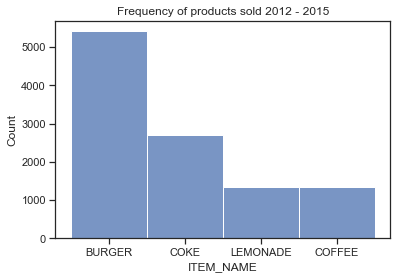

In [125]:
sbn.histplot(data=df, x='ITEM_NAME')
plt.title('Frequency of products sold 2012 - 2015')

Naturally sells of burger exceed all the rest of products sold. Let's remind ourselves, the data is range covers three years of commercial activity.

In [126]:
df_price = df.groupby(['YEAR', 'ITEM_NAME'])['PRICE'].mean().unstack()
df_price

ITEM_NAME,BURGER,COFFEE,COKE,LEMONADE
YEAR,,,,
2012,12.857945,11.851644,12.027260,12.206027
2013,12.922901,12.107946,12.275148,11.837892
2014,12.990781,12.140521,12.415616,12.026411
2015,12.634200,11.549328,11.845474,11.839921


Text(0.5, 1.0, 'Distibution of products prices 2012 - 2015')

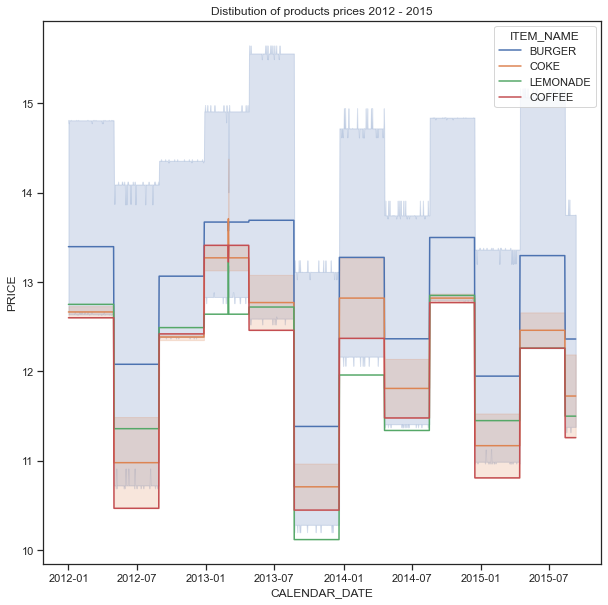

In [127]:
fig = plt.figure(figsize=(10, 10))
sbn.lineplot(data=df, x='CALENDAR_DATE', y='PRICE', hue='ITEM_NAME')
plt.title('Distibution of products prices 2012 - 2015')

#### Is there relation between price and quantity? 

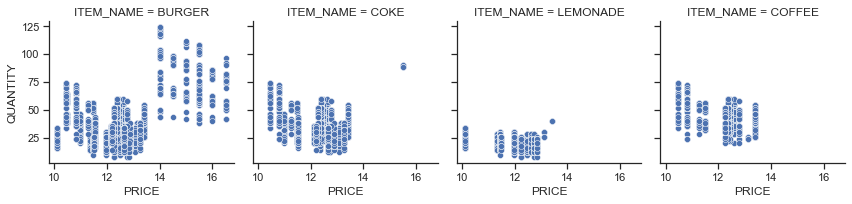

In [130]:
g = sbn.FacetGrid(df, col='ITEM_NAME')
g.map(sbn.scatterplot, 'PRICE', 'QUANTITY')

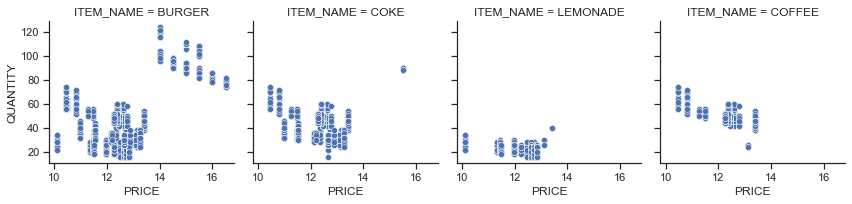

In [131]:
g = sbn.FacetGrid(df_filtered, col='ITEM_NAME')
g.map(sbn.scatterplot, 'PRICE', 'QUANTITY')

Comparison of these two plots from usual days and holidays shows that some fraction of sales dissapeared from the second group. Customers buy many more meals, separate bottles of coca and coffee on holidays and during weekends.

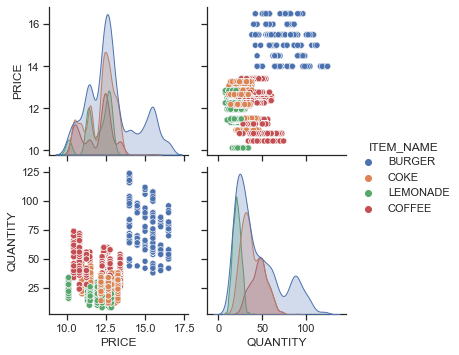

In [132]:
sbn.pairplot(df[['PRICE', 'QUANTITY', 'ITEM_NAME']], hue='ITEM_NAME')

We can see clear separation into groups. The higher price and quantity bought is specific for burger. Quantity of other products is lower despite that their prices are lower too. The peak in price is around 12, 16, which correspondents to bugers and coca.

In [191]:
df_burger_filtered = df_filtered[df_filtered['ITEM_NAME'] == 'BURGER']
df_burger_filtered

,SELL_ID,ITEM_ID,ITEM_NAME,CALENDAR_DATE,PRICE,QUANTITY,YEAR,HOLIDAY,IS_WEEKEND,IS_SCHOOLBREAK,AVERAGE_TEMPERATURE,IS_OUTDOOR
24,1070,7821,BURGER,2012-01-04,15.50,88,2012,Regular,0,0,32.0,1
25,2051,7821,BURGER,2012-01-04,12.73,26,2012,Regular,0,0,32.0,1
27,2052,7821,BURGER,2012-01-04,12.75,24,2012,Regular,0,0,32.0,1
29,2053,7821,BURGER,2012-01-04,12.60,42,2012,Regular,0,0,32.0,1
32,1070,7821,BURGER,2012-01-05,15.50,104,2012,Regular,0,0,24.8,0
...,...,...,...,...,...,...,...,...,...,...,...,...
10817,2053,7821,BURGER,2015-09-09,11.26,54,2015,Regular,0,0,71.6,1
10820,1070,7821,BURGER,2015-09-10,14.50,96,2015,Regular,0,0,73.4,1
10821,2051,7821,BURGER,2015-09-10,12.19,30,2015,Regular,0,0,73.4,1
10823,2052,7821,BURGER,2015-09-10,11.50,18,2015,Regular,0,0,73.4,1


In [192]:
df_burger_filtered.describe(include='all')

,SELL_ID,ITEM_ID,ITEM_NAME,CALENDAR_DATE,PRICE,QUANTITY,YEAR,HOLIDAY,IS_WEEKEND,IS_SCHOOLBREAK,AVERAGE_TEMPERATURE,IS_OUTDOOR
count,2842.000000,2842.0,2842,2842,2842.000000,2842.000000,2842.000000,2842,2842.0,2842.0,2842.000000,2842.000000
unique,NaN,NaN,1,705,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN
top,NaN,NaN,BURGER,2013-03-01 00:00:00,NaN,NaN,NaN,Regular,NaN,NaN,NaN,NaN
freq,NaN,NaN,2842,26,NaN,NaN,NaN,2842,NaN,NaN,NaN,NaN
first,NaN,NaN,NaN,2012-01-04 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,2015-09-10 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,1806.672062,7821.0,NaN,NaN,12.835369,49.465165,2013.222379,NaN,0.0,0.0,53.898944,0.880366
std,425.193674,0.0,NaN,NaN,1.566670,27.311358,1.065846,NaN,0.0,0.0,18.813435,0.324590
min,1070.000000,7821.0,NaN,NaN,10.120000,16.000000,2012.000000,NaN,0.0,0.0,14.000000,0.000000
25%,2051.000000,7821.0,NaN,NaN,11.530000,28.000000,2012.000000,NaN,0.0,0.0,35.600000,1.000000


In [193]:
df_burger_filtered['SELL_ID'].unique()

array([1070, 2051, 2052, 2053])

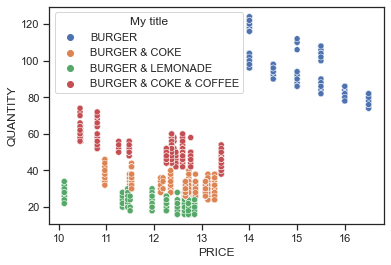

In [194]:
g = sbn.scatterplot(data=df_burger_filtered, x=df_burger_filtered['PRICE'], y=df_burger_filtered['QUANTITY'], hue=df_burger_filtered['SELL_ID'], palette="deep")
leg = g.axes.get_legend()
new_title = 'My title'
leg.set_title(new_title)
new_labels = ['BURGER', 'BURGER & COKE', 'BURGER & LEMONADE', 'BURGER & COKE & COFFEE']
for t, l in zip(leg.texts, new_labels): t.set_text(l)
plt.show()

It is clearly seen that different behaviours are defined by sell package. Burger is bought the most followed by combination burger and coke and coffee, followed by burger and coke, followed by burger and lemonade combination. Generally, sells fall into two distributions

Thus in order to model with respect to all the visible patterns we have to split the data into groups based on what the set each data point belongs to.

### Modeling

In [185]:
from statsmodels.formula.api import ols
import statsmodels.api as sm

In [195]:
burger_1070_filtered = df_burger_filtered[df_burger_filtered['SELL_ID'] == 1070]
# burger_2051 = df_burger[df_burger['SELL_ID'] == 2051]
# burger_2052 = df_burger[df_burger['SELL_ID'] == 2052]
# burger_2053 = df_burger[df_burger['SELL_ID'] == 2053]

In [196]:
burger_model = ols("QUANTITY ~ PRICE", data=burger_1070_filtered).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.210
Model:                            OLS   Adj. R-squared:                  0.208
Method:                 Least Squares   F-statistic:                     187.7
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           4.59e-38
Time:                        15:46:02   Log-Likelihood:                -2608.8
No. Observations:                 710   AIC:                             5222.
Df Residuals:                     708   BIC:                             5231.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    193.4514      7.470     25.897      0.0

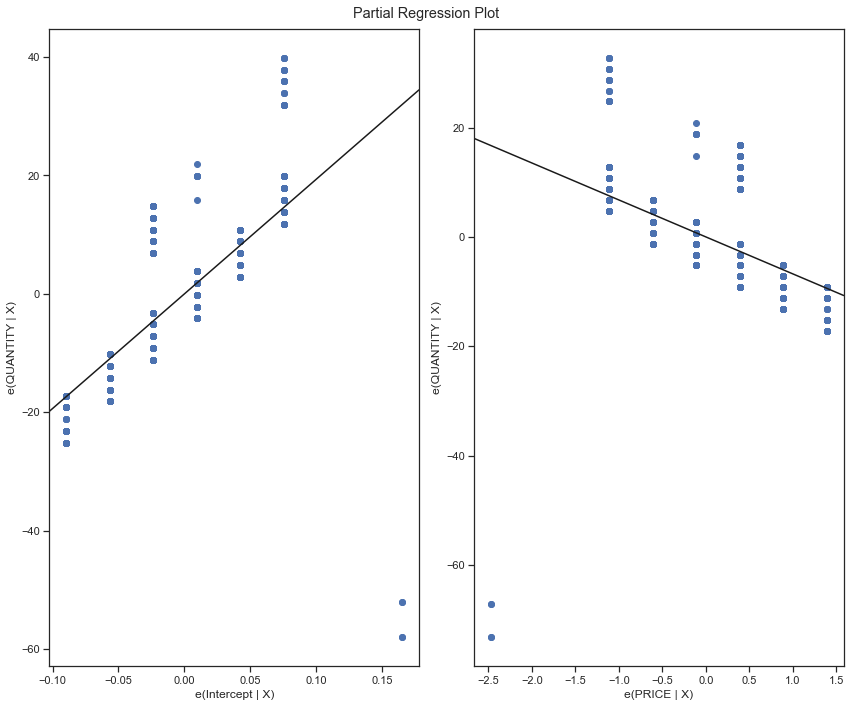

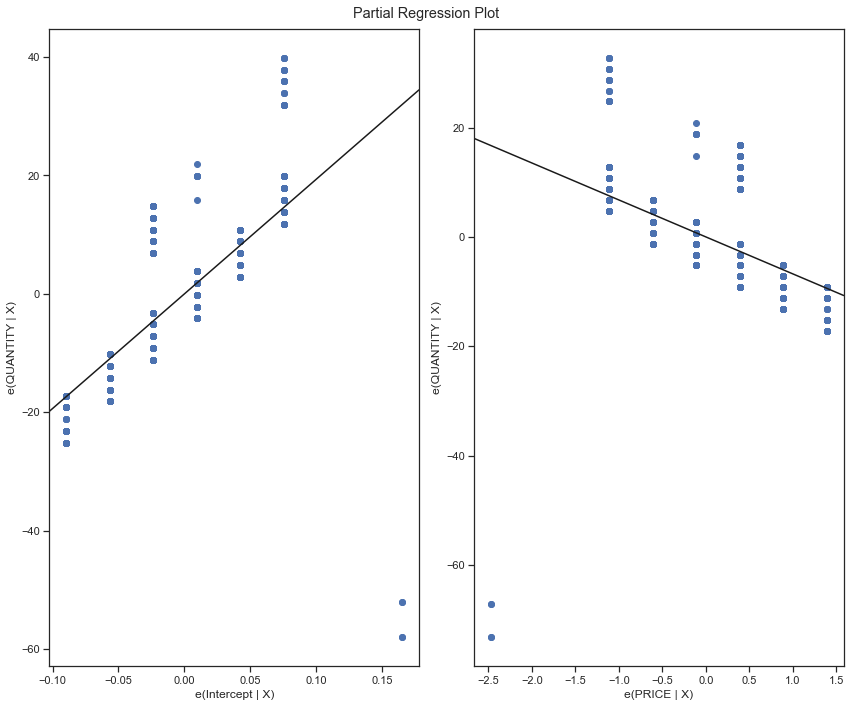

In [197]:
# plot
fig = plt.figure(figsize=(12, 10))
sm.graphics.plot_partregress_grid(burger_model, fig=fig)

In [200]:
# modeling on nonfiltered data
burger_1070_nonfiltered = df[(df['ITEM_NAME'] == 'BURGER') & (df['SELL_ID'] == 1070)]
burger_1070_nonfiltered.shape

(1353, 12)

In [201]:
burger_model = ols("QUANTITY ~ PRICE", data=burger_1070_nonfiltered).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.090
Model:                            OLS   Adj. R-squared:                  0.090
Method:                 Least Squares   F-statistic:                     134.3
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           1.13e-29
Time:                        15:58:51   Log-Likelihood:                -5664.3
No. Observations:                1353   AIC:                         1.133e+04
Df Residuals:                    1351   BIC:                         1.134e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    181.8340      8.686     20.935      0.0

In [202]:
# filtered data indoors 
df_filtered_indoors = df_filtered[df_filtered['IS_OUTDOOR'] == 0]
# filtered data for burgers sells 1070
burger_1070_df_filtered_indoors = df_filtered_indoors[(df_filtered_indoors['ITEM_NAME'] == 'BURGER') & (df_filtered_indoors['SELL_ID'] == 1070)]

In [203]:
burger_model = ols("QUANTITY ~ PRICE", data=burger_1070_df_filtered_indoors).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     522.1
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           1.48e-37
Time:                        16:08:39   Log-Likelihood:                -207.44
No. Observations:                  85   AIC:                             418.9
Df Residuals:                      83   BIC:                             423.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    268.6747      7.009     38.333      0.0

We have got much better reliable model which explains most variance in the data. 

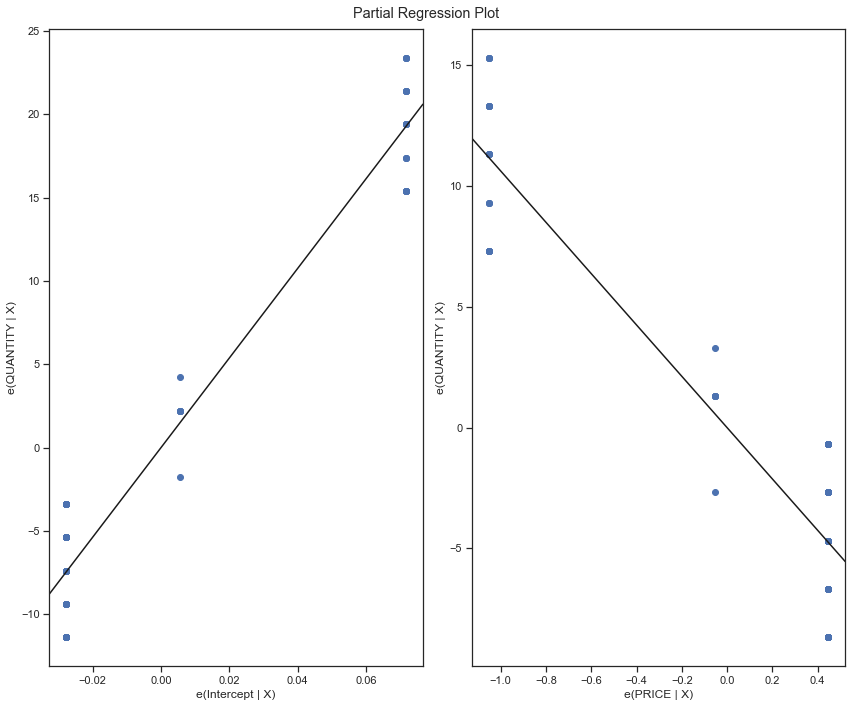

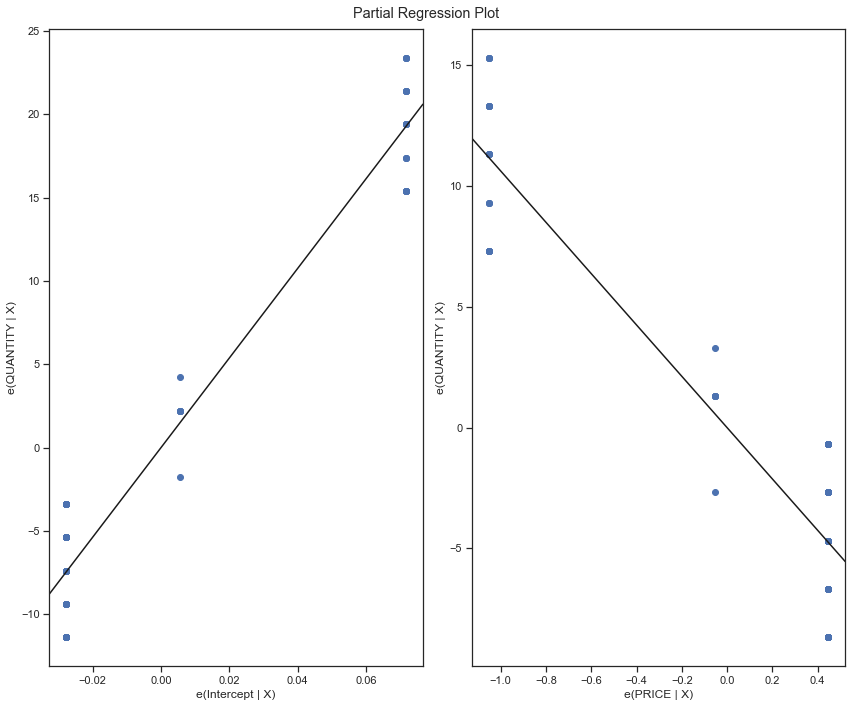

In [204]:
# plot
fig = plt.figure(figsize=(12, 10))
sm.graphics.plot_partregress_grid(burger_model, fig=fig)

### Model for all the products

In [205]:
sales_df

,SELL_ID,SELL_CATEGORY,ITEM_ID,ITEM_NAME
0,1070,0,7821,BURGER
1,3055,0,3052,COFFEE
2,3067,0,5030,COKE
3,3028,0,6249,LEMONADE
4,2051,2,7821,BURGER
5,2051,2,5030,COKE
6,2052,2,7821,BURGER
7,2052,2,6249,LEMONADE
8,2053,2,7821,BURGER
9,2053,2,5030,COKE


In [207]:
# burger bought with coke
burger_2051_df_filtered_indoors = df_filtered_indoors[(df_filtered_indoors['ITEM_NAME'] == 'BURGER') & (df_filtered_indoors['SELL_ID'] == 2051)]

# burger bought with lemonade
burger_2052_df_filtered_indoors = df_filtered_indoors[(df_filtered_indoors['ITEM_NAME'] == 'BURGER') & (df_filtered_indoors['SELL_ID'] == 2052)]

# burger bought with coke and coffee
burger_2053_df_filtered_indoors = df_filtered_indoors[(df_filtered_indoors['ITEM_NAME'] == 'BURGER') & (df_filtered_indoors['SELL_ID'] == 2053)]

In [208]:
# model for burger bought with coke
burger_model = ols("QUANTITY ~ PRICE", data=burger_2051_df_filtered_indoors).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.453
Model:                            OLS   Adj. R-squared:                  0.447
Method:                 Least Squares   F-statistic:                     68.79
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           1.69e-12
Time:                        16:21:06   Log-Likelihood:                -208.75
No. Observations:                  85   AIC:                             421.5
Df Residuals:                      83   BIC:                             426.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     76.7016      4.804     15.967      0.0

In [209]:
# model for burger bought with lemonade
burger_model = ols("QUANTITY ~ PRICE", data=burger_2052_df_filtered_indoors).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.446
Model:                            OLS   Adj. R-squared:                  0.440
Method:                 Least Squares   F-statistic:                     66.88
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           2.87e-12
Time:                        16:21:10   Log-Likelihood:                -201.74
No. Observations:                  85   AIC:                             407.5
Df Residuals:                      83   BIC:                             412.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     59.8796      4.161     14.390      0.0

In [210]:
# model for burger bought with coke and coffee
burger_model = ols("QUANTITY ~ PRICE", data=burger_2053_df_filtered_indoors).fit()
print(burger_model.summary())

                            OLS Regression Results                            
Dep. Variable:               QUANTITY   R-squared:                       0.853
Model:                            OLS   Adj. R-squared:                  0.851
Method:                 Least Squares   F-statistic:                     480.4
Date:                Mon, 21 Dec 2020   Prob (F-statistic):           2.88e-36
Time:                        16:21:14   Log-Likelihood:                -208.87
No. Observations:                  85   AIC:                             421.7
Df Residuals:                      83   BIC:                             426.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    143.6973      3.885     36.989      0.0

In [213]:
data_filtered_by_products = [burger_1070_df_filtered_indoors, burger_2051_df_filtered_indoors, burger_2052_df_filtered_indoors, burger_2053_df_filtered_indoors]
data_filtered_by_products_labels = ['burger_1070', 'burger_2051', 'burger_2052', 'burger_2053']

In [214]:
elasticities = {}
def model_and_get_elasticity(data):
    model = ols("QUANTITY ~ PRICE", data).fit()
    price_elasticity = model.params[1]
    return price_elasticity, model

In [232]:
for l, m in list(zip(data_filtered_by_products_labels, data_filtered_by_products)):
    p_e, model = model_and_get_elasticity(m)
    elasticities[l] = {'p_e': p_e, 'model': model}

In [233]:
elasticities

{'burger_1070': {'p_e': -10.628645078137577,
  'model': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x7f9fc8c47a30>},
 'burger_2051': {'p_e': -3.1764959042607757,
  'model': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x7f9fc9e47250>},
 'burger_2052': {'p_e': -2.829155241270175,
  'model': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x7f9fc8bcf910>},
 'burger_2053': {'p_e': -6.993348934027184,
  'model': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x7f9fc8c42580>}}

In [227]:
df_burger = df_filtered[(df_filtered['IS_OUTDOOR'] == 0) & (df_filtered['ITEM_NAME'] == 'BURGER')]

In [229]:
df_burger['PRICE'].min()

10.12

In [230]:
df_burger['PRICE'].max()

15.5

In [252]:
burger_cost = 8
start_pot_price = 8.5
#  max competitors price
end_pot_price = 18

In [253]:
test_df = pd.DataFrame(columns=['PRICE', 'QUANTITY'])
test_df['PRICE'] = np.arange(start_pot_price, end_pot_price, 0.01)

In [254]:
test_df['QUANTITY'] = elasticities['burger_1070']['model'].predict(test_df['PRICE'])

In [255]:
test_df

,PRICE,QUANTITY
0,8.50,178.331239
1,8.51,178.224952
2,8.52,178.118666
3,8.53,178.012380
4,8.54,177.906093
...,...,...
945,17.95,77.890543
946,17.96,77.784256
947,17.97,77.677970
948,17.98,77.571684


In [256]:
test_df['PROFIT'] = (test_df['PRICE'] - burger_cost)*test_df['QUANTITY']

In [257]:
test_df

,PRICE,QUANTITY,PROFIT
0,8.50,178.331239,89.165619
1,8.51,178.224952,90.894726
2,8.52,178.118666,92.621706
3,8.53,178.012380,94.346561
4,8.54,177.906093,96.069290
...,...,...,...
945,17.95,77.890543,775.010902
946,17.96,77.784256,774.731195
947,17.97,77.677970,774.449361
948,17.98,77.571684,774.165402


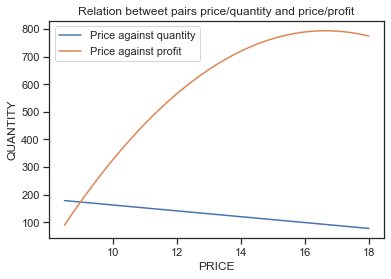

In [258]:
sbn.lineplot(x="PRICE", y="QUANTITY", data=test_df, label='Price against quantity')
sbn.lineplot(x="PRICE", y="PROFIT", data=test_df, label='Price against profit')
plt.title('Relation betweet pairs price/quantity and price/profit')
plt.show()

Now we can see clearly that as price increasing the profit increasing up to a certain point and then starts to decrease, thus we can find a point of price which will maximize the profit.

In [259]:
optimal_dp = test_df[test_df['PROFIT'] == test_df['PROFIT'].max()]

In [260]:
optimal_dp

,PRICE,QUANTITY,PROFIT
814,16.64,91.814068,793.273547


The price you should put for gaining maximum profit is $16.64 and expected quality to sell is 92 burgers. This is suggested pricing for regular days with no holidays, weekends and school breaks.